In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

import folium
from folium import GeoJson
from folium.features import GeoJsonTooltip, CustomIcon

In [ ]:
# Load the shapefile
file_path = "/content/drive/MyDrive/Colab/LTS/BOS_streets/boston_streets.shp"
gdf = gpd.read_file(file_path)

gdf.shape

(36863, 217)

In [ ]:
class TrafficStressCalculator:
    def segment_lts(self, FEDERALFUN, qExclude, qProtected, ILLPARKING, BL_WIDTH, BL_REACH, Lanes_OW, NUMLANE, ADT_Infer, StOperNEU, qDirLanes, SPEED):

        """
        Calculate the LTS for a segment based on segment type and traffic characteristics.

        :param FEDERALFUN
        :param qExclude
        :param qProtected: 1 if cycle track or separated bike path; 0 otherwise
        :param ILLPARKING: 1 if drivers are frequently illegally parked in bike lane; 0 otherwise
        :param BL_WIDTH: width of bike lane; 0 if no bike lane
        :param BL_REACH: bike lane reach; 0 if no bike lane
        :param Lanes_OW
        :param NUMLANE
        :param ADT_Infer
        :param StOperNEU
        :param qDirLanes
        :param SPEED
        """

        # Interstate, freeway, expressway
        if FEDERALFUN in [1, 2]:
            return 6

        # Private road
        if qExclude == 1:
            return 5

        # Separated Path Segment
        if qProtected == 1:
            return 1


        # Mixed Traffic Segment
        elif not (BL_WIDTH or BL_REACH) or ILLPARKING == 1:

            # Case 1: Narrow one-way street
            if StOperNEU in [1, 11] and Lanes_OW < 2:
                if ADT_Infer <= 750:
                    return 1 if SPEED <= 30.1 else 2 if SPEED <= 40.1 else 3
                elif ADT_Infer <= 1_000:
                    return 2 if SPEED <= 35.1 else 3 if SPEED <= 45.1 else 4
                else:  # For adt > 1,000
                    return 2 if SPEED <= 25.1 else 3 if SPEED <= 40.1 else 4

            # Case 2: Unlaned two-way street (no centerline)
            elif NUMLANE == 1 and qDirLanes == 0:
                if ADT_Infer <= 750:
                    return 1 if SPEED <= 30.1 else 2 if SPEED <= 40.1 else 3
                elif ADT_Infer <= 1_500:
                    return 1 if SPEED <= 30.1 else 2 if SPEED <= 35.1 else 3 \
                    if SPEED <= 45.1 else 4
                elif ADT_Infer <= 3_000:
                    return 2 if SPEED <= 35.1 else 3 if SPEED <= 40.1 else 4
                else:  # For adt > 3,000
                    return 2 if SPEED <= 30.1 else 3 if SPEED <= 40.1 else 4

            # Case 3: Two-way street with one through lane per direction and a centerline
            elif NUMLANE == 1 and qDirLanes != 0:
                if ADT_Infer <= 1_000:
                    return 1 if SPEED <= 30.1 else 2 if SPEED <= 40.1 else 3
                elif ADT_Infer <= 1_500:
                    return 2 if SPEED <= 35.1 else 3 if SPEED <= 45.1 else 4
                else:  # For adt > 1,500
                    return 2 if SPEED <= 25.1 else 3 if SPEED <= 40.1 else 4

            # Case 4: Two through lanes per direction
            elif NUMLANE == 2:
                if ADT_Infer <= 8_000:
                    return 3 if SPEED <= 40.1 else 4
                else:  # For adt > 8,000
                    return 3 if SPEED <= 30.1 else 4

            # Case 5: Three or more through lanes per direction
            else:
                return 3 if SPEED <= 30.1 else 4


        # Bike Lane without Adjacent Parking
        elif BL_WIDTH and not ILLPARKING:

            # Case 1: One through lane per direction or unlaned
            if NUMLANE == 1 or qDirLanes == 0:
                if BL_WIDTH >= 6.1:
                    return 1 if SPEED <= 35.1 else 2 if SPEED <= 40.1 else 3
                else: # for bike_lane_width < 6 ft
                    return 2 if SPEED <= 40.1 else 3 if SPEED <= 50.1 else 4

            # Case 2: Two through lanes per direction
            elif NUMLANE == 2:
                if BL_WIDTH >= 6.1:
                    return 2 if SPEED <= 40.1 else 3
                else: # for bike_lane_width < 6 ft
                    return 2 if SPEED <= 40.1 else 3 if SPEED <= 45.1 else 4

            # Case 3: Three or more through lanes per direction
            else:
                if BL_WIDTH: # any bike lane width
                    return 3 if SPEED <= 40.1 else 4


        # Bike Lane with Adjacent Parking
        elif BL_REACH and not ILLPARKING:

            # Case 1: One through lane per direction or unlaned
            if NUMLANE == 1:
                if BL_REACH >= 15.1:
                    return 1 if SPEED <= 30.1 else 2 if SPEED <= 40.1 else 3
                else: # for bike reach < 15 ft
                    return 2 if SPEED <= 35.1 else 3

            # Case 2: Two through lanes per direction
            elif NUMLANE == 2:
                if BL_REACH >= 15.1:
                    return 2 if SPEED <= 30.1 else 3
                else: # for bike reach < 15 ft
                    return 3

            # Case 3: All other multilane configurations
            else:
                return 3
        else:
            # Default to LTS 99, if no condition above matches. Inspect them later.
            return 99

In [ ]:
# Only display relevant columns
selected_columns = ["FEDERALFUN", "qExclude", "qProtected", "ILLPARKING", "BL_WIDTH", "BL_REACH", "Lanes_OW", "NUMLANE", "ADT_Infer", "StOperNEU", "qDirLanes", "SPEED", "geometry"]

gdf = gdf[selected_columns]
gdf.head()

,FEDERALFUN,qExclude,qProtected,ILLPARKING,BL_WIDTH,BL_REACH,Lanes_OW,NUMLANE,ADT_Infer,StOperNEU,qDirLanes,SPEED,geometry
0,0,0,1,0,0,0,0,0,3001,2,1,30,"LINESTRING (233242.758 895808.486, 233222.49 8..."
1,5,0,0,0,0,0,0,2,3001,2,1,30,"LINESTRING (230853.372 905550.496, 230815.825 ..."
2,1,0,0,0,0,0,0,9,8001,0,5,30,"LINESTRING (237830.56 899715.092, 237875.357 8..."
3,3,0,1,0,0,0,0,6,8001,2,3,35,"LINESTRING (235406.018 902000.001, 235384.466 ..."
4,7,0,0,0,0,0,0,2,749,1,1,25,"LINESTRING (235011.22 899539.093, 235185.812 8..."


In [ ]:
# Calculate segment LTS
calc = TrafficStressCalculator()

gdf.loc[:, 'LTS_nd'] = gdf.apply(lambda row: calc.segment_lts(
    row['FEDERALFUN'], row['qExclude'], row['qProtected'], row['ILLPARKING'],
    row['BL_WIDTH'], row['BL_REACH'], row['Lanes_OW'], row['NUMLANE'],
    row['ADT_Infer'], row['StOperNEU'], row['qDirLanes'], row['SPEED']
), axis=1)

# Handle any NaN values and round LTS values to integers
# gdf['LTS_nd'] = df['LTS_nd'].fillna(0).apply(lambda x: int(round(x)))

gdf

,FEDERALFUN,qExclude,qProtected,ILLPARKING,BL_WIDTH,BL_REACH,Lanes_OW,NUMLANE,ADT_Infer,StOperNEU,qDirLanes,SPEED,geometry,LTS_nd
0,0,0,1,0,0,0,0,0,3001,2,1,30,"LINESTRING (233242.758 895808.486, 233222.49 8...",1
1,5,0,0,0,0,0,0,2,3001,2,1,30,"LINESTRING (230853.372 905550.496, 230815.825 ...",3
2,1,0,0,0,0,0,0,9,8001,0,5,30,"LINESTRING (237830.56 899715.092, 237875.357 8...",6
3,3,0,1,0,0,0,0,6,8001,2,3,35,"LINESTRING (235406.018 902000.001, 235384.466 ...",1
4,7,0,0,0,0,0,0,2,749,1,1,25,"LINESTRING (235011.22 899539.093, 235185.812 8...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36858,7,0,0,0,0,0,0,0,749,1,1,25,"LINESTRING (232548.935 904084.058, 232616.526 ...",1
36859,7,0,0,0,0,0,0,2,749,1,1,25,"LINESTRING (230289.375 887947.75, 230240.309 8...",1
36860,0,1,0,0,0,0,0,0,3001,0,1,30,"LINESTRING (232262.021 892034.149, 232251.983 ...",5
36861,4,0,0,0,0,0,0,2,3001,2,1,30,"LINESTRING (234406.906 895534.313, 234419.5 89...",3


In [36]:
gdf["LTS_nd"].value_counts()

,count
LTS_nd,
3,18054
1,8841
5,6082
2,2187
6,1573
4,126


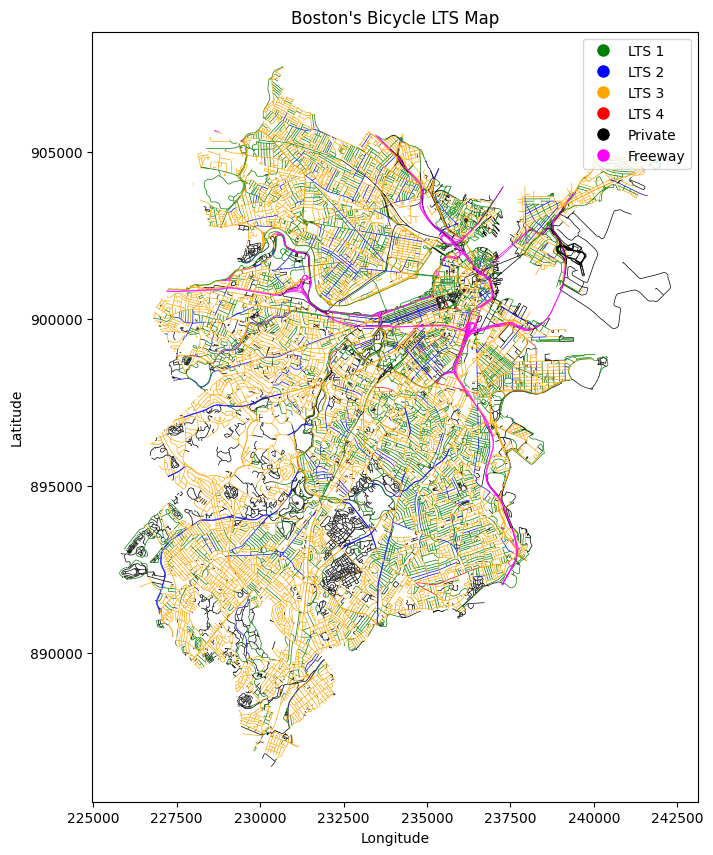

In [41]:
# Treat 'LTS_nd' as categorical
gdf['LTS_nd'] = gdf['LTS_nd'].astype('category')

# Define a custom color map
color_map = {
    1: 'green',    # LTS 1
    2: 'blue',     # LTS 2
    3: 'orange',   # LTS 3
    4: 'red',      # LTS 4
    5: 'black',    # Private road
    6: 'magenta'   # Freeway or limited-access road
}

# Create a list of colors corresponding to the categories
colors_list = [color_map[int(val) + 1] for val in gdf['LTS_nd'].cat.codes]

# Plotting the data with categorical colors
fig, ax = plt.subplots(figsize=(10, 10))
gdf.plot(ax=ax, color=colors_list, edgecolor='black', linewidth=0.5)

# Create a custom legend
from matplotlib.lines import Line2D

legend_labels = {
    1: 'LTS 1',
    2: 'LTS 2',
    3: 'LTS 3',
    4: 'LTS 4',
    5: 'Private',
    6: 'Freeway'
}

legend_elements = [Line2D([0], [0], marker='o', color='w', label=legend_labels[k],
                          markerfacecolor=color_map[k], markersize=10) for k in color_map.keys()]
ax.legend(handles=legend_elements, title_fontsize='13')

# Add title and labels
ax.set_title("Boston's Bicycle LTS Map")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Show the plot
plt.show()

In [42]:
# Map colors to the 'LTS_nd' column
gdf['color'] = gdf['LTS_nd'].map(color_map)

# Create a Folium map centered on Boston
m = folium.Map(location=[42.3601, -71.0589], zoom_start=12)

# JavaScript for adaptive line thickness
adaptive_line_thickness = """
function(feature, layer) {
    var zoom = map.getZoom();
    var weight = zoom >= 14 ? 3 : zoom >= 12 ? 2 : 1;
    layer.setStyle({
        color: feature.properties.color,
        weight: weight,
        opacity: 0.8
    });
}
"""

# Add GeoJson layer with adaptive line thickness
geojson = GeoJson(
    gdf,
    style_function=lambda feature: {
        'color': feature['properties']['color'],
        'weight': 2,
        'opacity': 0.8
    },
    tooltip=GeoJsonTooltip(
        fields=['LTS_nd'],
        aliases=['LTS Level:'],
        sticky=False
    )
).add_to(m)

# Attach JavaScript for line thickness adjustment
m.get_root().html.add_child(folium.Element(f'<script>{adaptive_line_thickness}</script>'))

# Define custom legend with colored boxes using HTML
legend_html = '''
    <div style="position: fixed;
                bottom: 50px; left: 50px; width: 150px; height: auto;
                border:2px solid grey; z-index:9999;
                font-size:14px; background-color:white; padding: 10px;">
    <h4 style="text-align:center; margin-top: 0;">LTS Legend</h4>
    <div><span style="display:inline-block; width:15px; height:15px; background-color:green; margin-right:5px;"></span>LTS 1</div>
    <div><span style="display:inline-block; width:15px; height:15px; background-color:blue; margin-right:5px;"></span>LTS 2</div>
    <div><span style="display:inline-block; width:15px; height:15px; background-color:orange; margin-right:5px;"></span>LTS 3</div>
    <div><span style="display:inline-block; width:15px; height:15px; background-color:red; margin-right:5px;"></span>LTS 4</div>
    <div><span style="display:inline-block; width:15px; height:15px; background-color:black; margin-right:5px;"></span>Private</div>
    <div><span style="display:inline-block; width:15px; height:15px; background-color:magenta; margin-right:5px;"></span>Freeway</div>
    </div>
'''

# Add the legend to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
m

# Save the map
# m.save('boston_lts_map.html')